In [124]:
import spacy
import en_core_web_lg
import os
import re
import matplotlib

font = {'weight' : 'bold',
        'size'   : 30}

matplotlib.rc('font', **font)

import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from matplotlib import pyplot as plt
from pdf_converter import PDFToText

In [2]:
nlp = en_core_web_lg.load()
pdf_converter_engine = PDFToText()

In [3]:
root_syllabus_dir = os.path.join('data', 'syllabus')
assert os.path.isdir(root_syllabus_dir)

In [4]:
class TextPreprocessor():
    def __init__(self):
        pass
    
    def preprocess(self, text: str):
        text = text.replace('\n', '')
        text = text.lower()
        text = re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', text)
        text = re.sub(r'[^A-Za-z0-9]+', ' ', text)
        text = re.sub(r'[\d.]', '', text)
        text = text.replace('achge', '')
        
        return text
    
text_preprocessor_engine = TextPreprocessor()

## Preprocess Data

In [5]:
text_map = {}

for country in os.listdir(root_syllabus_dir):
    country_syllabus_dir = os.path.join(root_syllabus_dir, country)
    assert (os.path.isdir(country_syllabus_dir))
    
    for file in os.listdir(country_syllabus_dir):
        file_path = os.path.join(country_syllabus_dir, file)
        assert os.path.isfile(file_path)
        
        if(file_path.endswith('.pdf')):
            text_content = pdf_converter_engine.convert(file_path)
            text_content = text_preprocessor_engine.preprocess(text_content)
            
            file_name = file.replace('.pdf', '')
            with open(file_path.replace('.pdf', '.txt'), "w") as text_file:
                text_file.write(text_content)
                
            text_map[f"{file_name}"] = text_content

In [6]:
text_map

{'EUR GEOG 2015': '  d  en    european schools office of the secretary general pedagogical development unit ref   d  en  orig en geography syllabus for the secondary cycle s s approved by the joint teaching committee on  and  february  in brussels entry into force on  september  for s on  september  for s   d  en    geography is an integrated subject considered to be both a science and a social science subject it plays an important role in developing scientific and technological literacy in students this feature of geography also offers the potential for a wide range of cross curricular opportunities the syllabus aims to develop basic skills and knowledge across a wide variety of human and physical geographical topics it aims to provide a firm foundation from which students can progress to either two period or four period geography in year  and year  geography should provide students with the ability to understand the world around them and become empathetic and active european citizens

In [7]:
text_entities = {}

for key, value in text_map.items():
    doc = nlp(value)
    
    text_entities[key] = set()
    for ent in doc.ents:
        if(ent.label_ not in ['CARDINAL', 'DATE']):
            text_entities[key].add(ent.text)

In [8]:
text_entities

{'EUR GEOG 2015': {'aeolian',
  'anticyclones',
  'atlas',
  'brussels',
  'compass',
  'corrie pyramidal peak ar te',
  'dtm',
  'earth',
  'eu',
  'europe',
  'european',
  'fao green revolution fair trade',
  'first',
  'geo',
  'gis',
  'gis ict',
  'gis transects',
  'gm',
  'google',
  'ict',
  'mediterranean',
  'second',
  'the european council',
  'the joint teaching committee',
  'un',
  'valley dunes'},
 'German 2014': {'aa',
  'aban',
  'about   km',
  'about metres',
  'abuja  ',
  'ac quired general competences',
  'accu',
  'actorspl iiexplain',
  'africa',
  'ag',
  'alexander von humboldt',
  'alexandra budke',
  'alfred wegener',
  'alps',
  'althoff autobahnbr cke althoff motor',
  'althoff s farm',
  'ana',
  'andes',
  'answerno',
  'answersstandardspl',
  'answersstandardspl k s m c e',
  'antarctic',
  'anthroposphere',
  'antje schneider',
  'ap',
  'arctic',
  'ards bonn',
  'armen der meeresspiegelanstieg',
  'asia',
  'asia india',
  'asian',
  'atlas model a

## Count Vectorizer (Terms Frequencies)

In [9]:
text_keys = list(text_map.keys())
text_values = list(text_map.values())

vectorizer = CountVectorizer(stop_words='english', ngram_range=(1, 3))
X = vectorizer.fit_transform(text_values)

In [10]:
feature_names = vectorizer.get_feature_names()
feature_names

['aa',
 'aa bridge',
 'aa bridge ca',
 'aa ca',
 'aa ca km',
 'aa included',
 'aa included plan',
 'aa lake',
 'aa lake near',
 'ab',
 'ab calculated',
 'ab calculated average',
 'ab drei',
 'ab drei schluchten',
 'aban',
 'aban doned',
 'aban doned population',
 'abandoned',
 'abandoned derelict',
 'abandoned derelict used',
 'abandoned measures',
 'abandoned measures adopted',
 'abandonment',
 'abandonment urban',
 'abandonment urban sprawl',
 'abbott',
 'abbott cooper',
 'abbott cooper farmer',
 'abbreviation',
 'abbreviation denotes',
 'abbreviation denotes individual',
 'abc',
 'abc clio',
 'abc clio ritchie',
 'abenteuer',
 'abenteuer regenwald',
 'abenteuer regenwald wissen',
 'abholzung',
 'abholzung wwf',
 'abholzung wwf published',
 'abilities',
 'abilities apply',
 'abilities apply problem',
 'abilities aptitudes',
 'abilities aptitudes generic',
 'abilities assessment',
 'abilities assessment practices',
 'abilities attributes',
 'abilities attributes fundamental',
 'abilit

In [11]:
print(X.toarray())

[[0 0 0 ... 0 0 0]
 [4 1 1 ... 1 1 1]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [13]:
text_tokens = {}

for key, values in zip(text_keys, X.toarray()):
    text_tokens[key] = {k: v for k, v in dict(zip(feature_names, values)).items() if v}

    sorted_tuples = sorted(text_tokens[key].items(), key=lambda item: item[1], reverse=True)
    text_tokens[key] = {k: v for k, v in sorted_tuples}

text_tokens

{'EUR GEOG 2015': {'students': 29,
  'learning': 26,
  'different': 21,
  'assessment': 19,
  'urban': 18,
  'en': 17,
  'year': 17,
  'explain': 16,
  'population': 16,
  'skills': 16,
  'understand': 15,
  'climate': 13,
  'development': 13,
  'learning outcomes': 13,
  'lessons': 13,
  'maps': 13,
  'outcomes': 13,
  'geography': 12,
  'student': 12,
  'european': 11,
  'key': 11,
  'world': 11,
  'able': 10,
  'eu': 10,
  'knowledge': 10,
  'structure': 10,
  'study': 10,
  'documents': 9,
  'region': 9,
  'teaching': 9,
  'types': 9,
  'weather': 9,
  'contents': 8,
  'food': 8,
  'human': 8,
  'keywords': 8,
  'migration': 8,
  'objectives': 8,
  'range': 8,
  'students able': 8,
  'theme': 8,
  'use': 8,
  'areas': 7,
  'case': 7,
  'documents lessons': 7,
  'en theme': 7,
  'en theme learning': 7,
  'following': 7,
  'gis': 7,
  'graphs': 7,
  'land': 7,
  'language': 7,
  'learning outcomes contents': 7,
  'outcomes contents': 7,
  'social': 7,
  'syllabus': 7,
  'theme learni

In [427]:
text_tokens

{'EUR GEOG 2015': {'students': 29,
  'learning': 26,
  'different': 21,
  'assessment': 19,
  'urban': 18,
  'en': 17,
  'year': 17,
  'explain': 16,
  'population': 16,
  'skills': 16,
  'understand': 15,
  'climate': 13,
  'development': 13,
  'learning outcomes': 13,
  'lessons': 13,
  'maps': 13,
  'outcomes': 13,
  'geography': 12,
  'student': 12,
  'european': 11,
  'key': 11,
  'world': 11,
  'able': 10,
  'eu': 10,
  'knowledge': 10,
  'structure': 10,
  'study': 10,
  'documents': 9,
  'region': 9,
  'teaching': 9,
  'types': 9,
  'weather': 9,
  'contents': 8,
  'food': 8,
  'human': 8,
  'keywords': 8,
  'migration': 8,
  'objectives': 8,
  'range': 8,
  'students able': 8,
  'theme': 8,
  'use': 8,
  'areas': 7,
  'case': 7,
  'documents lessons': 7,
  'en theme': 7,
  'en theme learning': 7,
  'following': 7,
  'gis': 7,
  'graphs': 7,
  'land': 7,
  'language': 7,
  'learning outcomes contents': 7,
  'outcomes contents': 7,
  'social': 7,
  'syllabus': 7,
  'theme learni

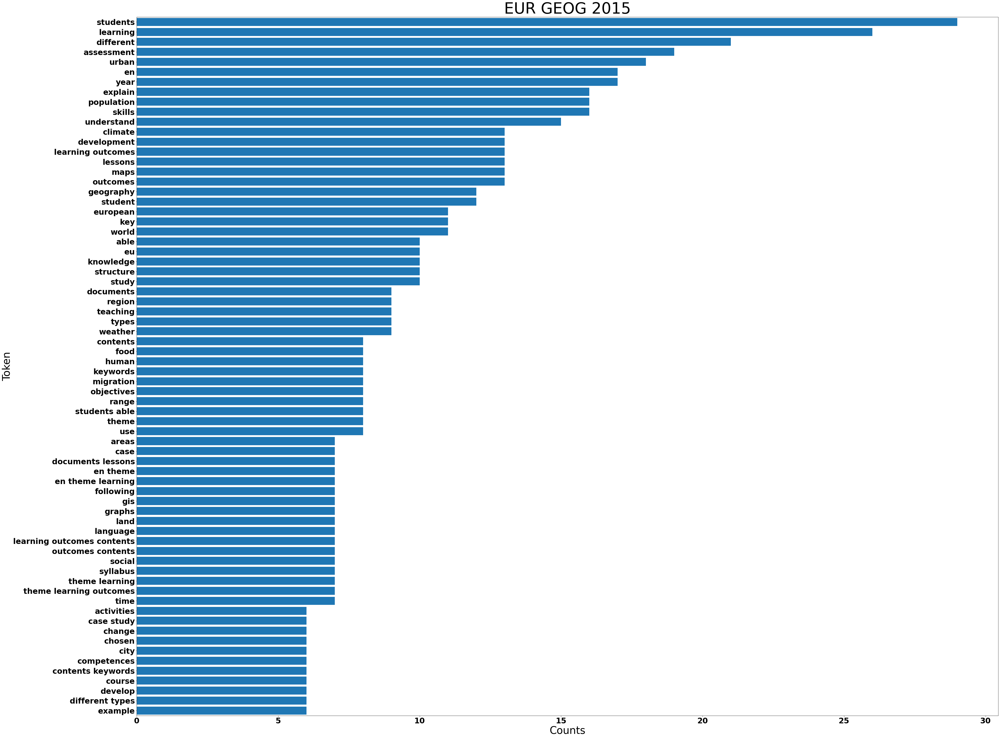

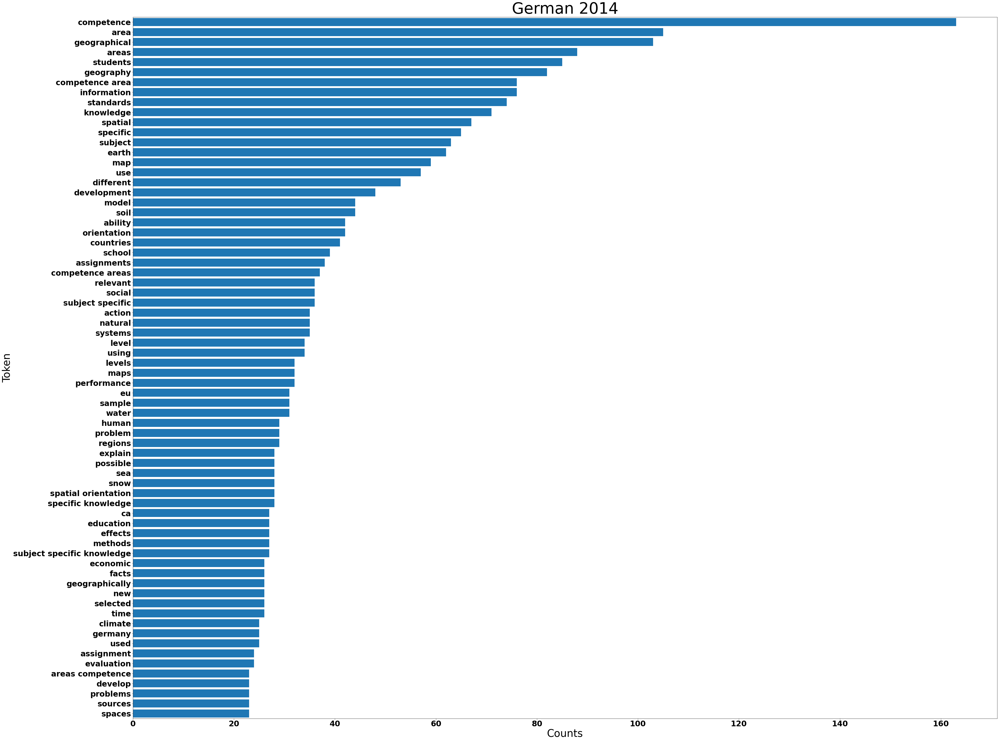

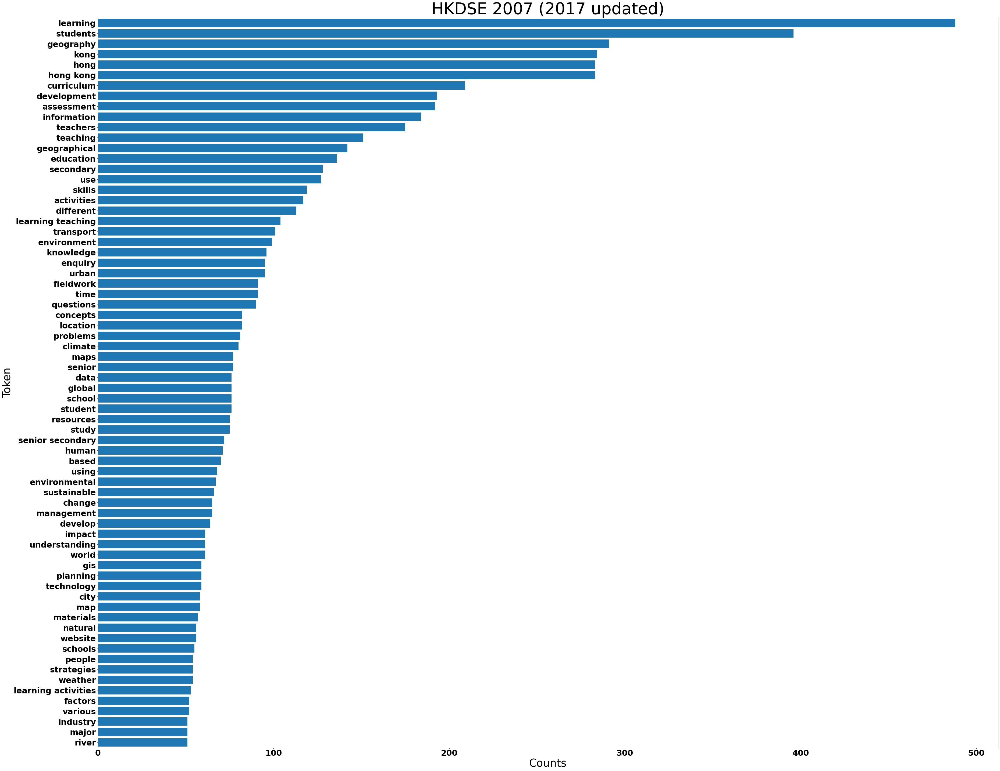

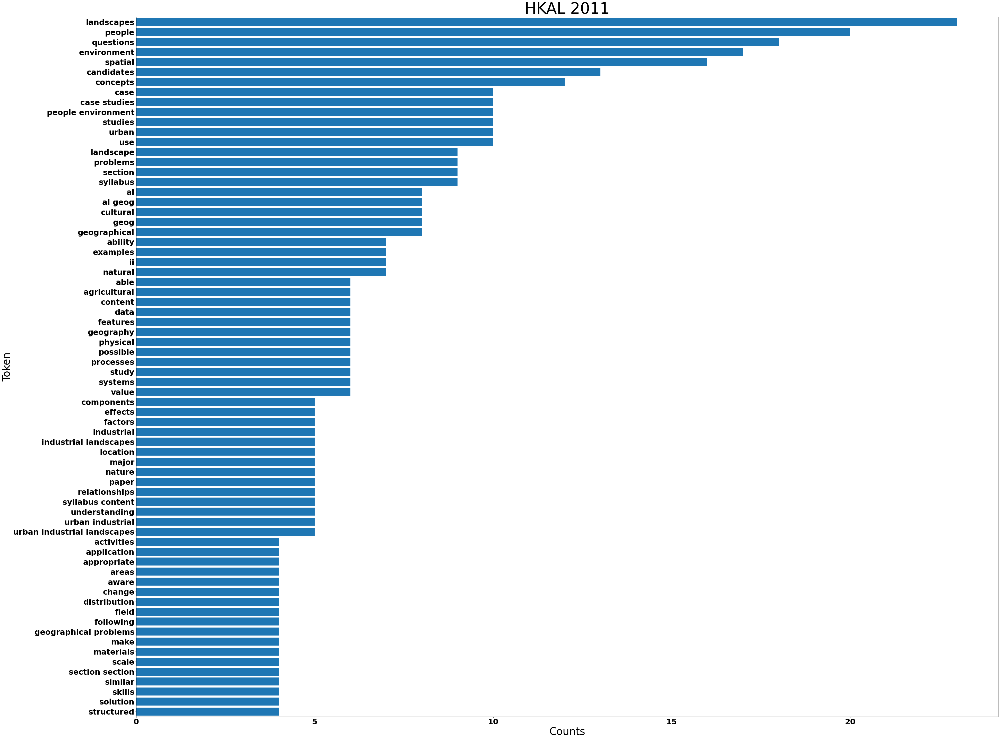

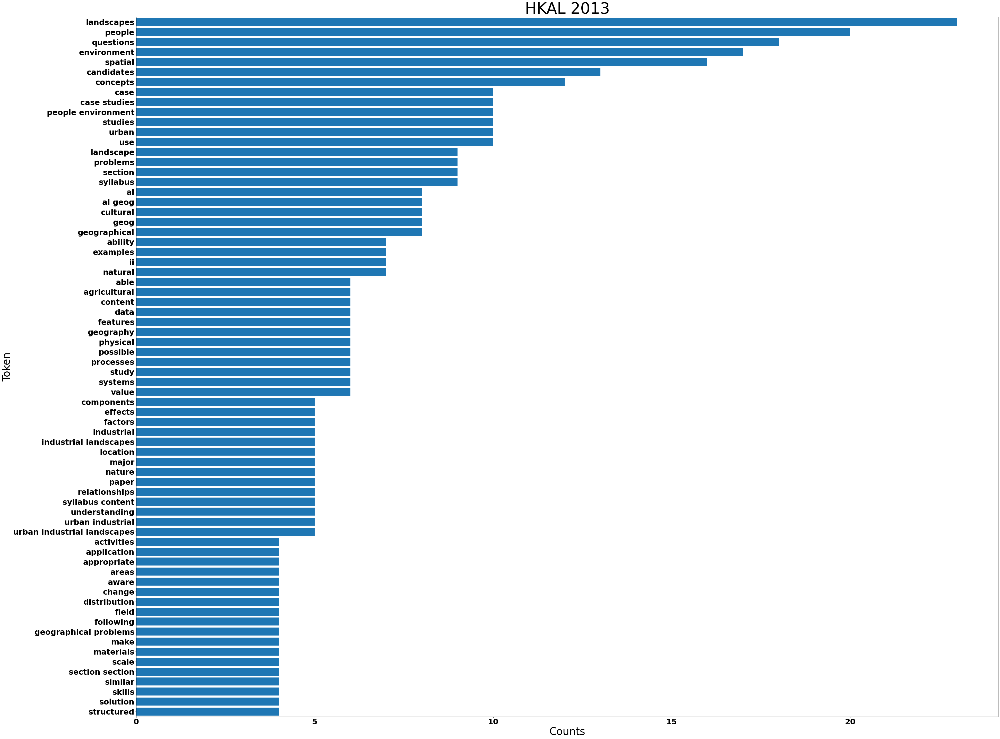

...

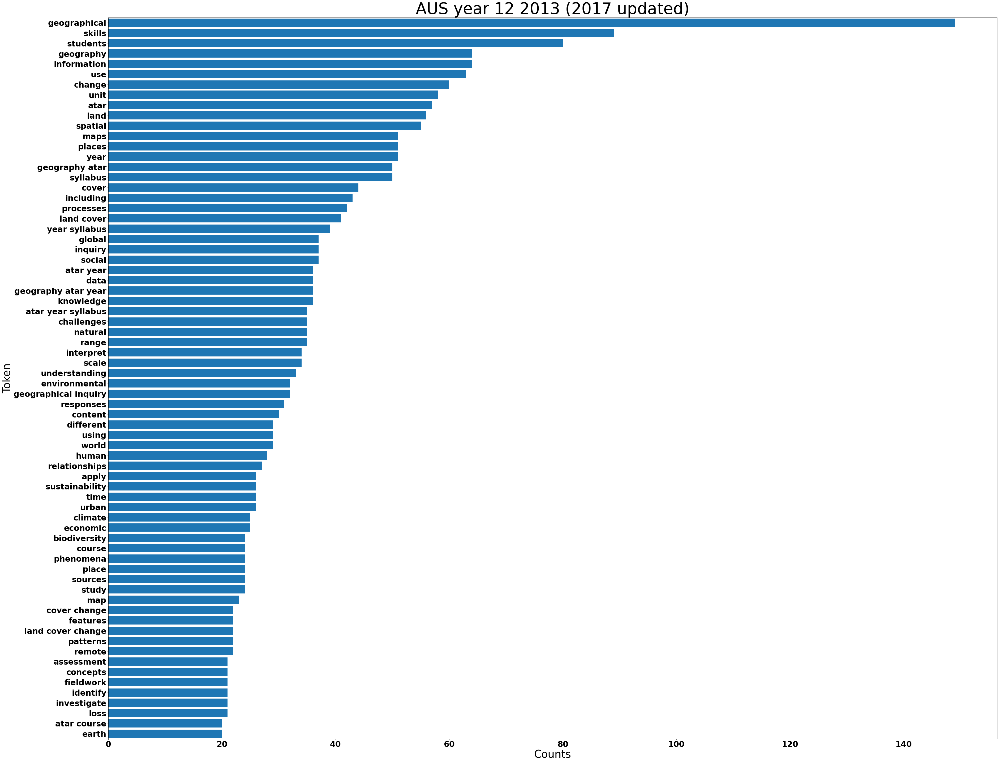

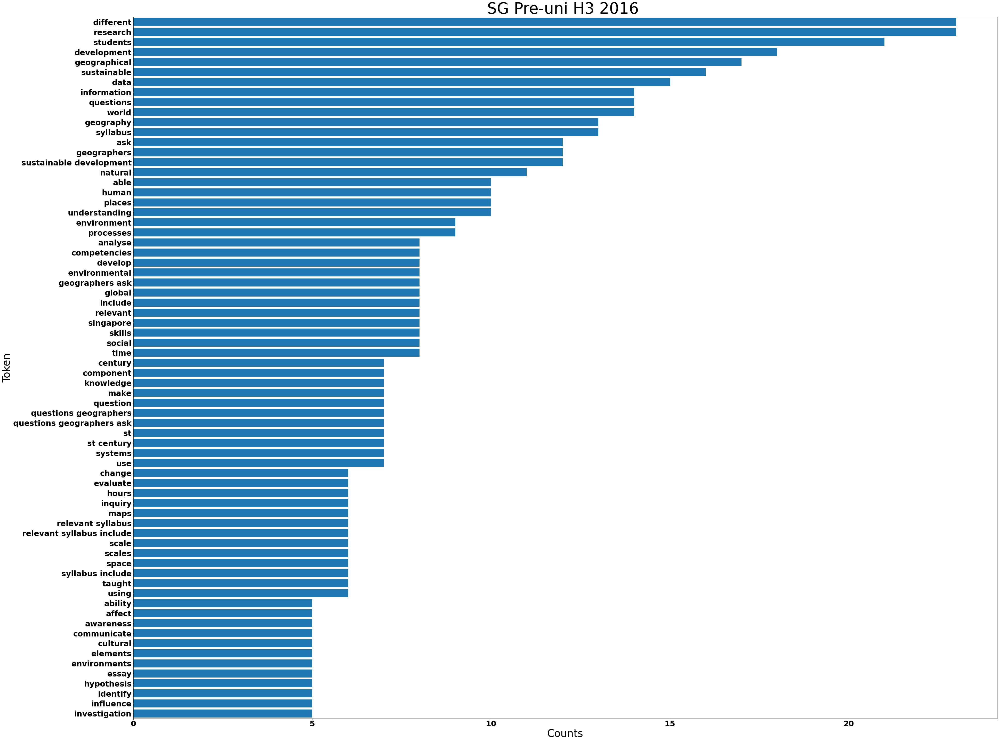

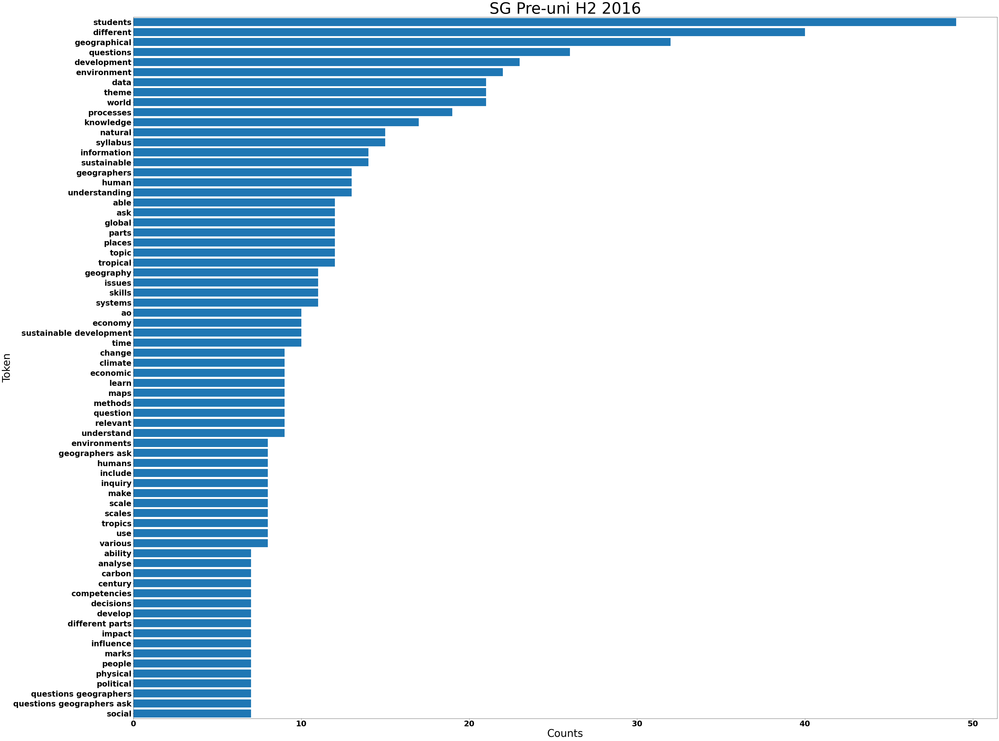

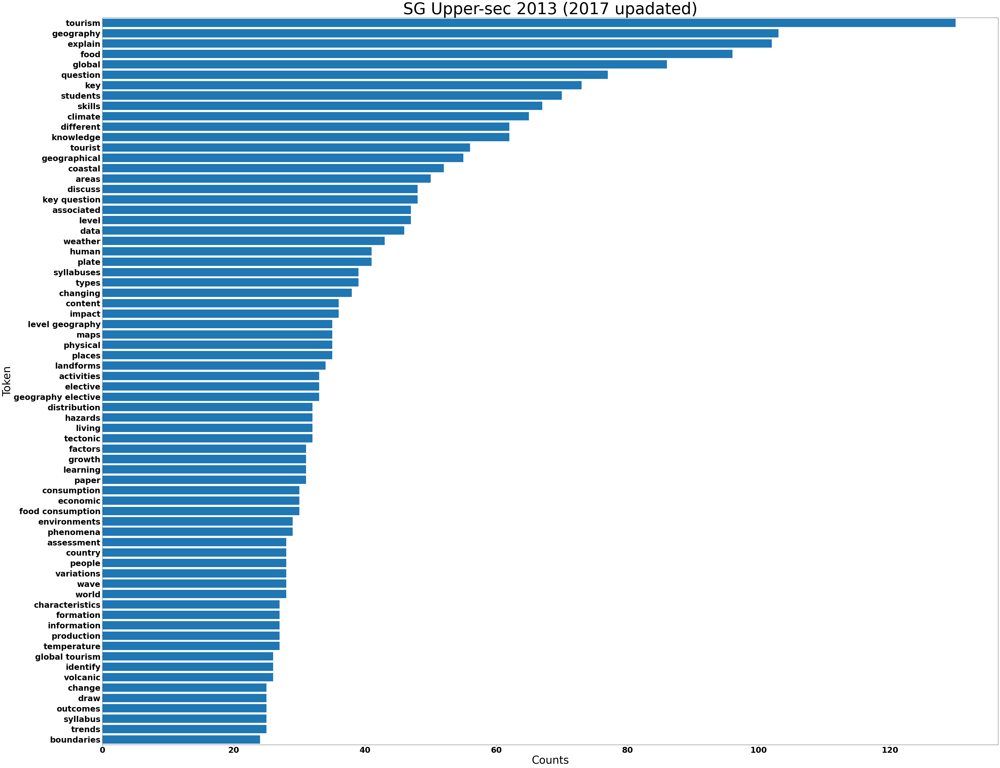

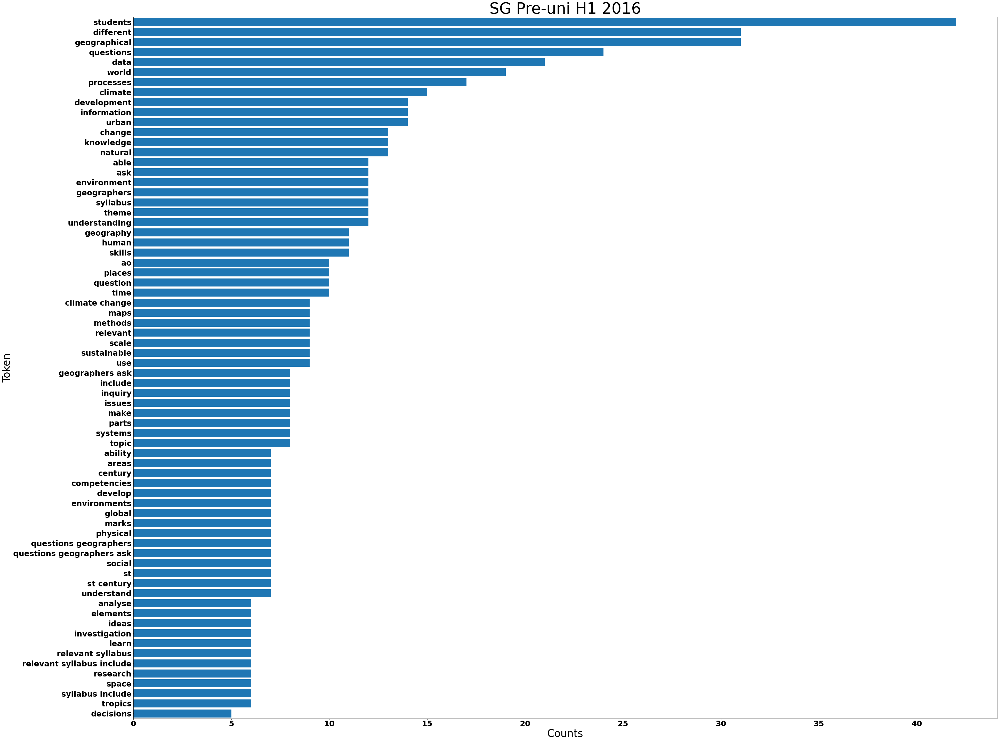

In [54]:
def plot_bar_horizontal(values, title, values_shown_count=70, x_label="x", y_label="y", save_path="./"):
    assert (len(values) >= values_shown_count)
    is_save_path_valid = save_path.endswith(".pdf") or save_path.endswith(".png")
    save_path = save_path if is_save_path_valid else f"{os.path.join(save_path, title)}.pdf"
    
    fig = plt.figure(figsize = (60, 50)) 
  
    plt.xlabel("Counts", fontsize=40) 
    plt.ylabel("Token", fontsize=40) 

    plt.title(title, fontsize=60)
    plt.barh(list(values.keys())[:values_shown_count][::-1], width=(list(values.values()))[:values_shown_count][::-1])
    plt.ylim(-0.5,values_shown_count-.5)
    plt.savefig(save_path, transparent=False)
    plt.show()

for key, values in text_tokens.items():
    plot_bar_horizontal(values, key, x_label="Count", y_label="Token", save_path=os.path.join("output", "terms-frequency"))

## TF-IDF Vectorizer (Terms Importances)

In [55]:
tfidf_vectorizer = TfidfVectorizer(stop_words='english', ngram_range=(1, 3))
X2 = tfidf_vectorizer.fit_transform(text_values)

In [56]:
print(X2.toarray())

[[0.         0.         0.         ... 0.         0.         0.        ]
 [0.01236983 0.00309246 0.00309246 ... 0.00309246 0.00309246 0.00309246]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]


In [57]:
text_tokens_tfidf = {}

for key, values in zip(text_keys, X2.toarray()):
    text_tokens_tfidf[key] = {k: v for k, v in dict(zip(feature_names, values)).items() if v}

    sorted_tuples = sorted(text_tokens_tfidf[key].items(), key=lambda item: item[1], reverse=True)
    text_tokens_tfidf[key] = {k: v for k, v in sorted_tuples}

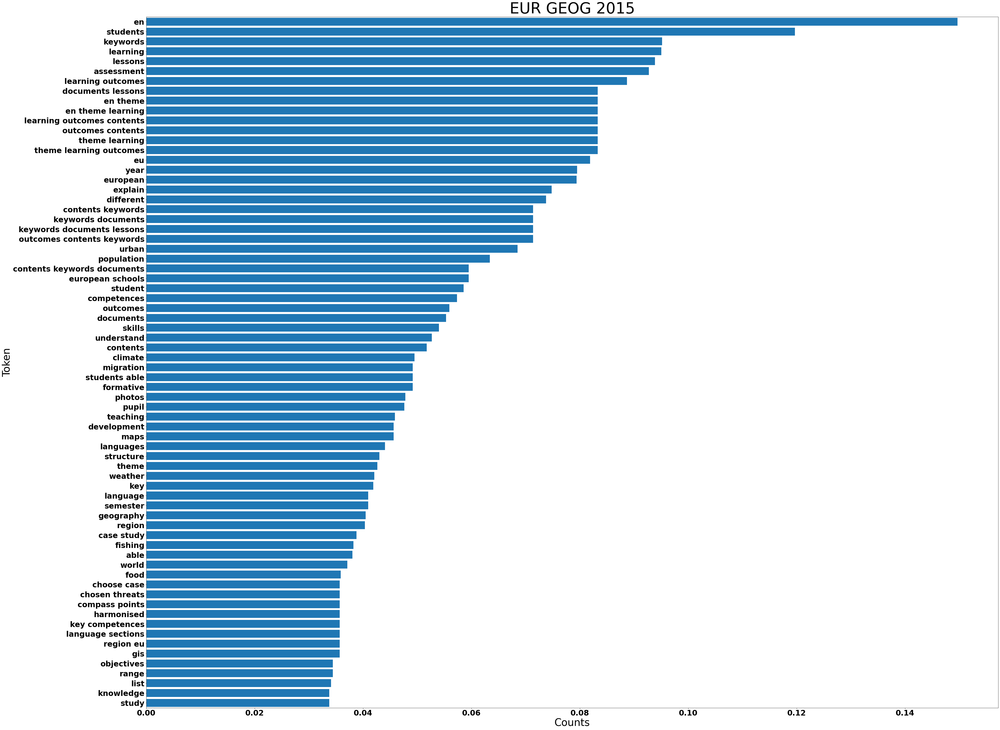

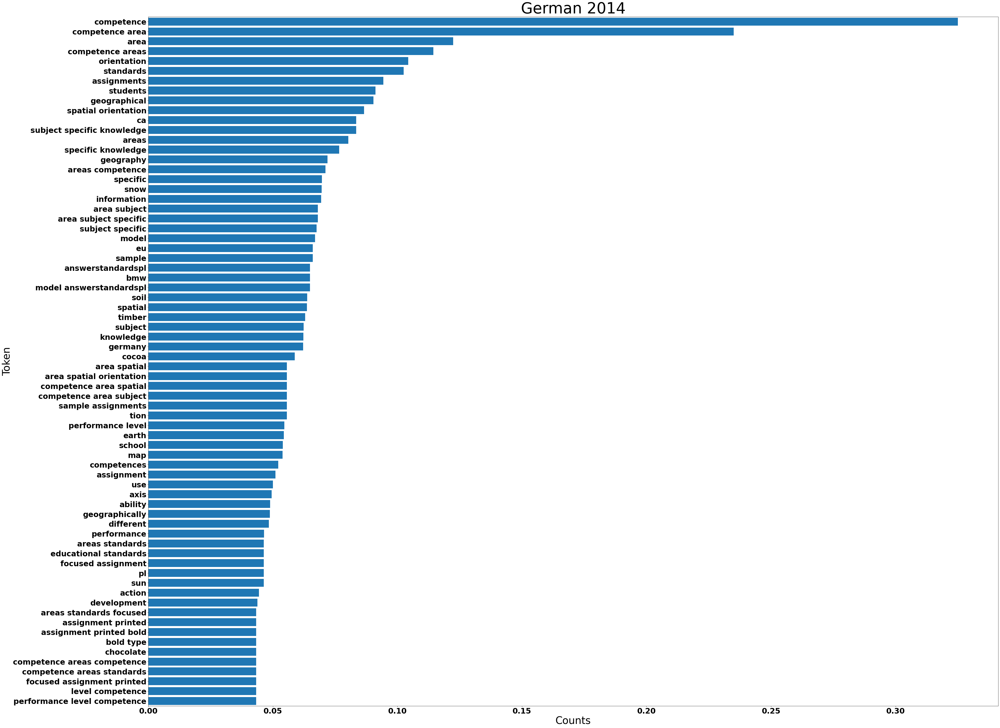

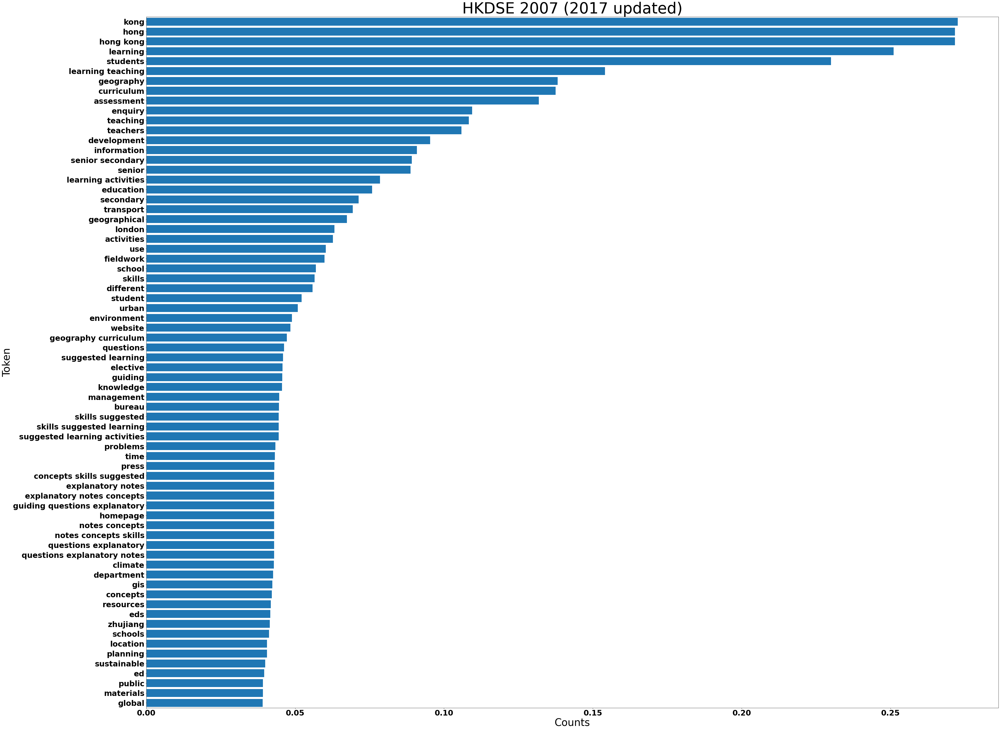

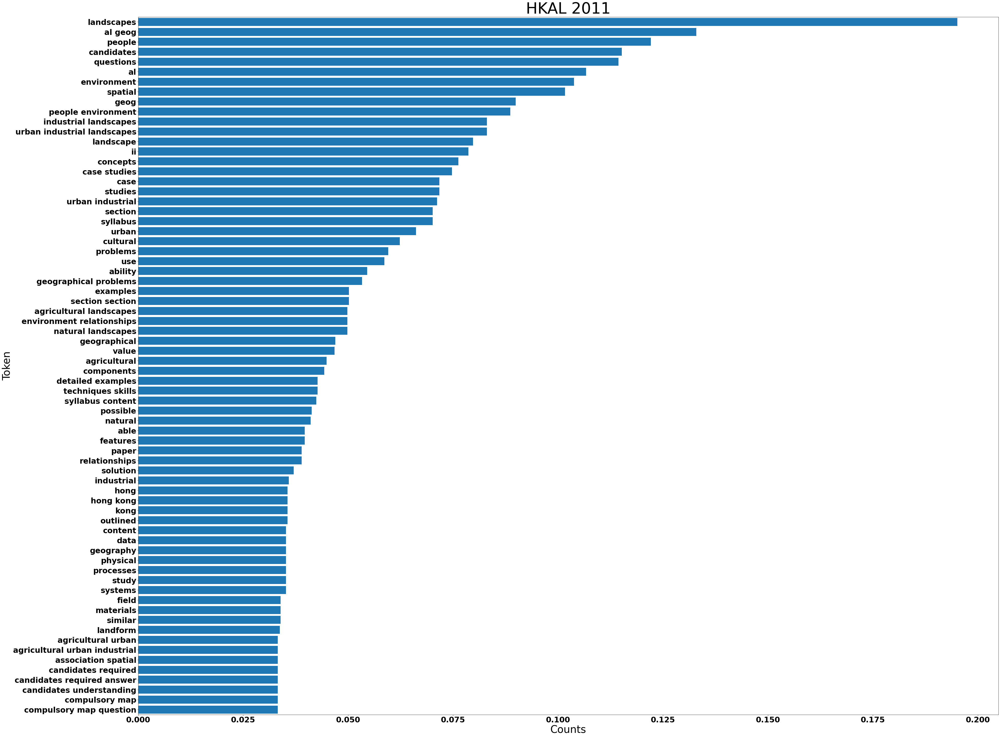

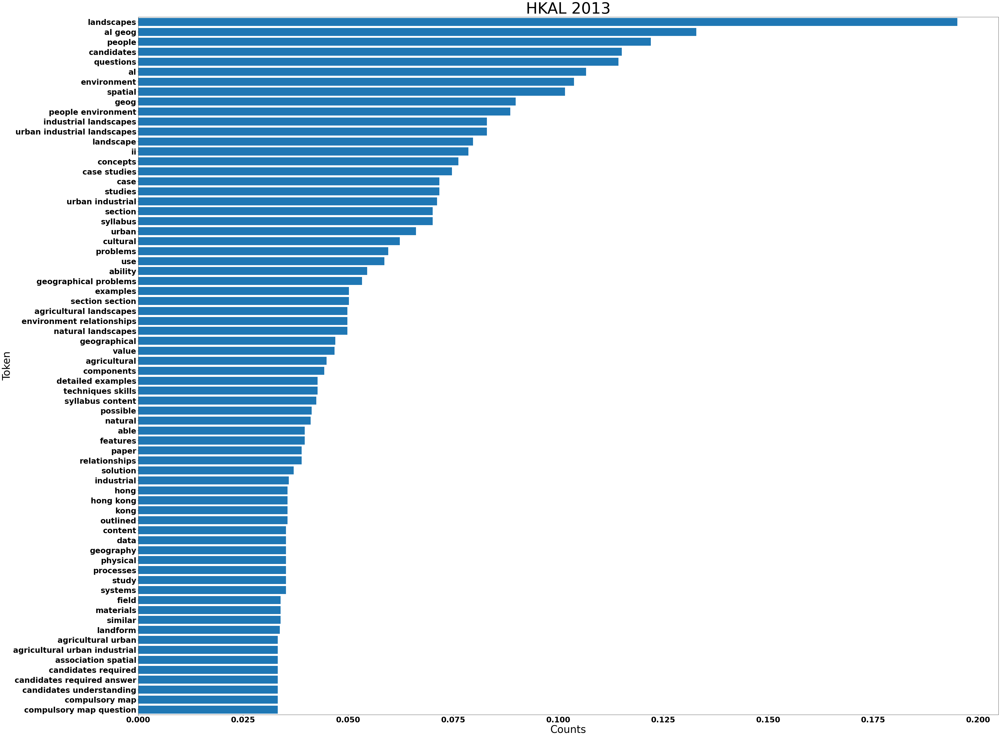

...

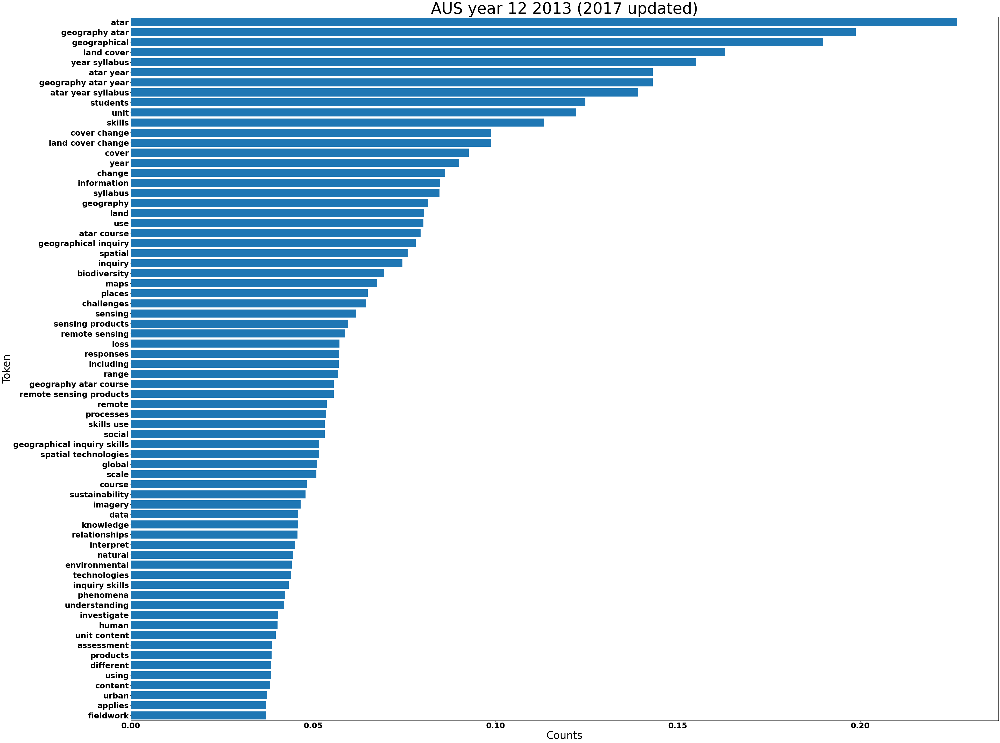

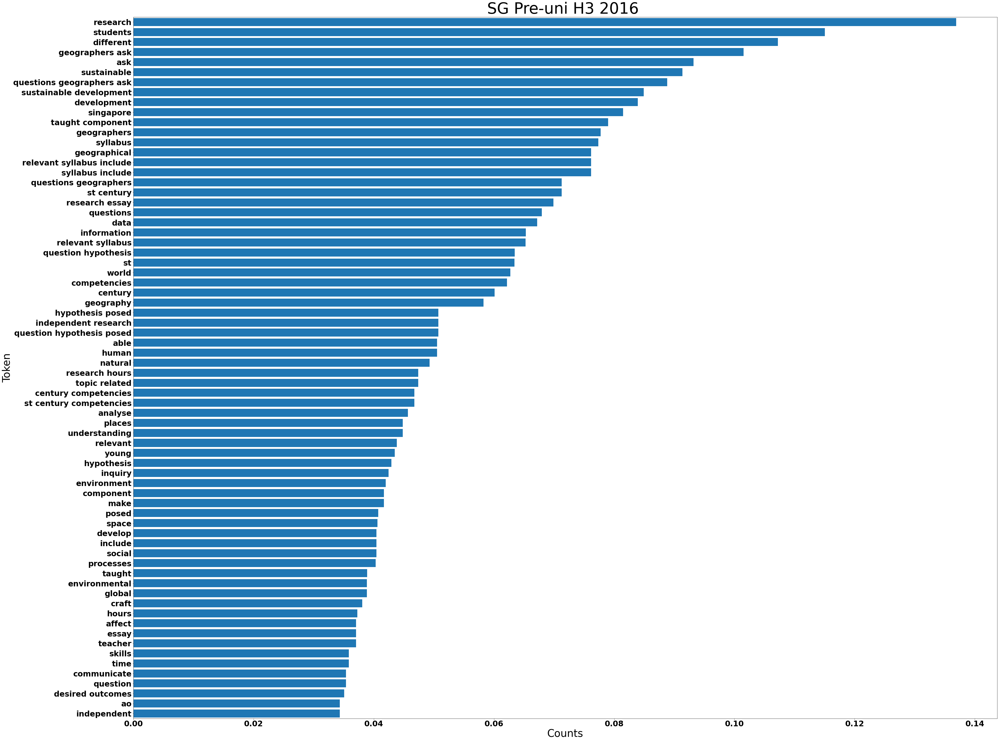

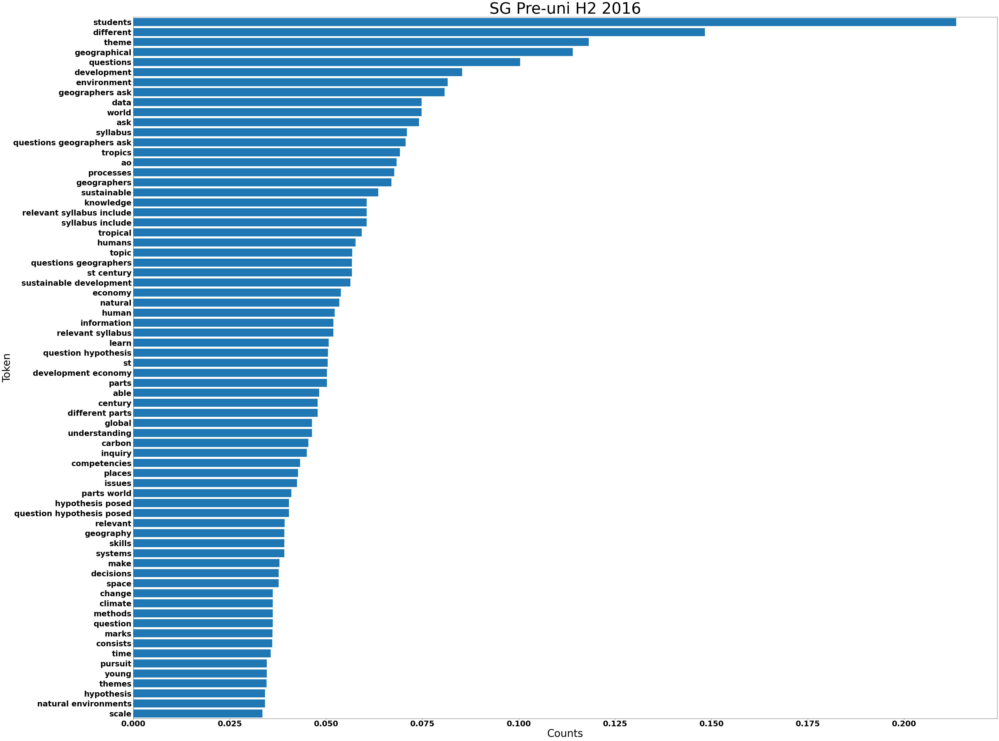

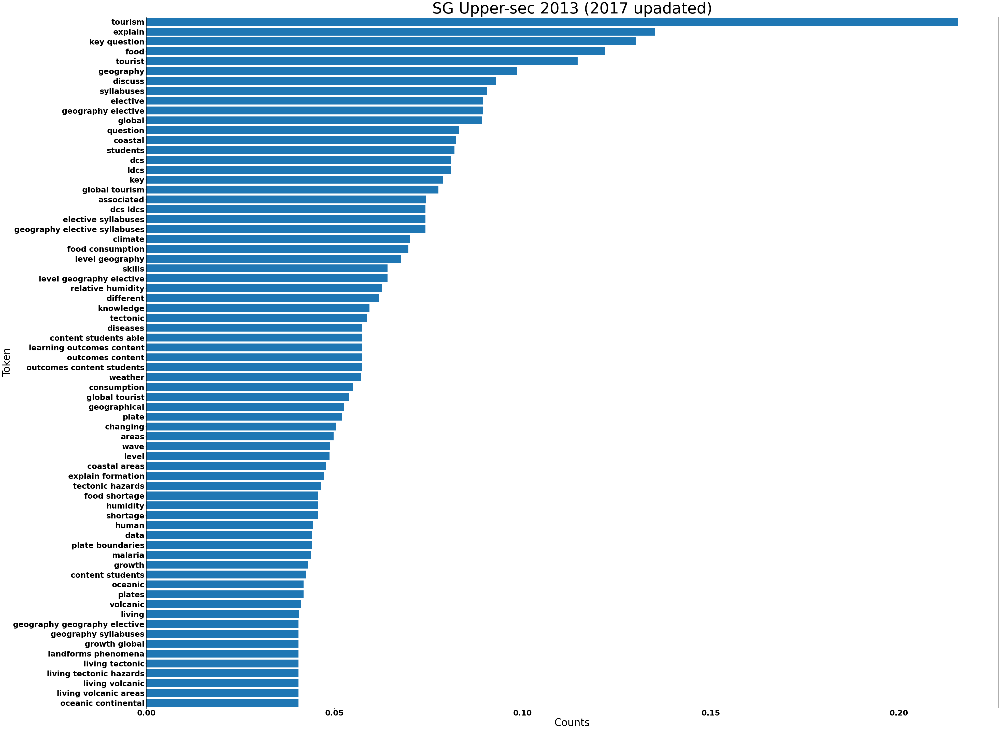

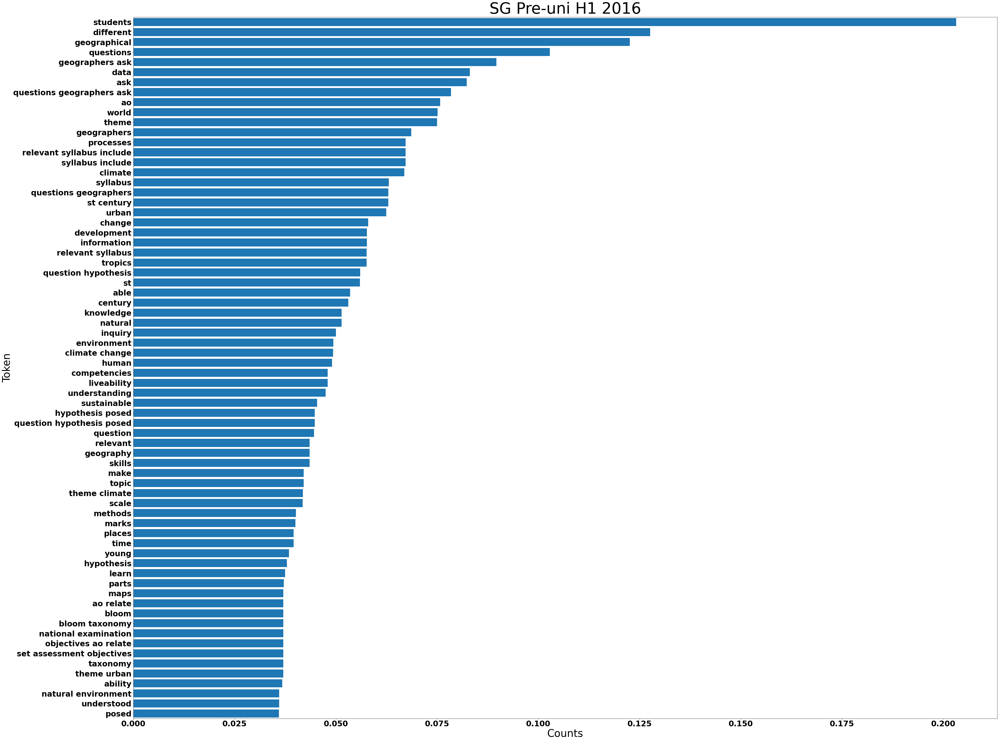

In [58]:
for key, values in text_tokens_tfidf.items():
    plot_bar_horizontal(values, key, x_label="Count", y_label="Token", save_path=os.path.join("output", "tf-idf"))

## HK, AUS, IB Syllabuses Differences and Similarities

In [157]:
[doc_name for doc_name in list(text_tokens.keys())]

['EUR GEOG 2015',
 'German 2014',
 'HKDSE 2007 (2017 updated)',
 'HKAL 2011',
 'HKAL 2013',
 'HKCEE 2010',
 'HKCEE 2011',
 'HKAL 2012',
 'HKDSE 2007 (2015 updated)',
 'HKCEE 2009',
 'IB GEOG 2011',
 'IB GEOG  2019',
 'UK 2014 GEOG stage 1-2',
 'GCSE Geography 2016 (2018 updated)',
 'UK curriculum plan',
 'A Level GEOG 2021-2022',
 'A level GEOG 2018-2020',
 'UK 2013 GEOG stage 3',
 'AUS year 11 2013 (2015 updated)',
 'AUS year 12 2013 (2017 updated)',
 'SG Pre-uni H3 2016 ',
 'SG Pre-uni H2 2016',
 'SG Upper-sec 2013 (2017 upadated)',
 'SG Pre-uni H1 2016']

In [158]:
class Document():
    def __init__(self, tokens_frequency):
        self.tokens_frequency = tokens_frequency
        self.tokens = set(tokens_frequency.keys())
        self.unique_tokens_frequency = {}
        self.unique_tokens = set()
        self.common_tokens_frequency = {}
        self.common_tokens = set()
        
        self.tokens_proportion = {}
        tokens_count = sum(list(tokens_frequency.values()))
        for key, value in tokens_frequency.items():
            self.tokens_proportion[key] = value*1000/tokens_count
        
    def fit_unique_tokens(self, *args):
        self.unique_tokens = self.tokens
        self.common_tokens = self.tokens
        
        for document in args:
            if(self == document):
                continue
            assert document.tokens_frequency
            self.unique_tokens = self.unique_tokens.difference(document.tokens)
            self.common_tokens = self.common_tokens.intersection(document.tokens)
        
        self.unique_tokens_frequency = {k: v for k, v in self.tokens_frequency.items() if k in self.unique_tokens}
        self.common_tokens_frequency = {k: v for k, v in self.tokens_frequency.items() if k in self.common_tokens}

## Australia Data

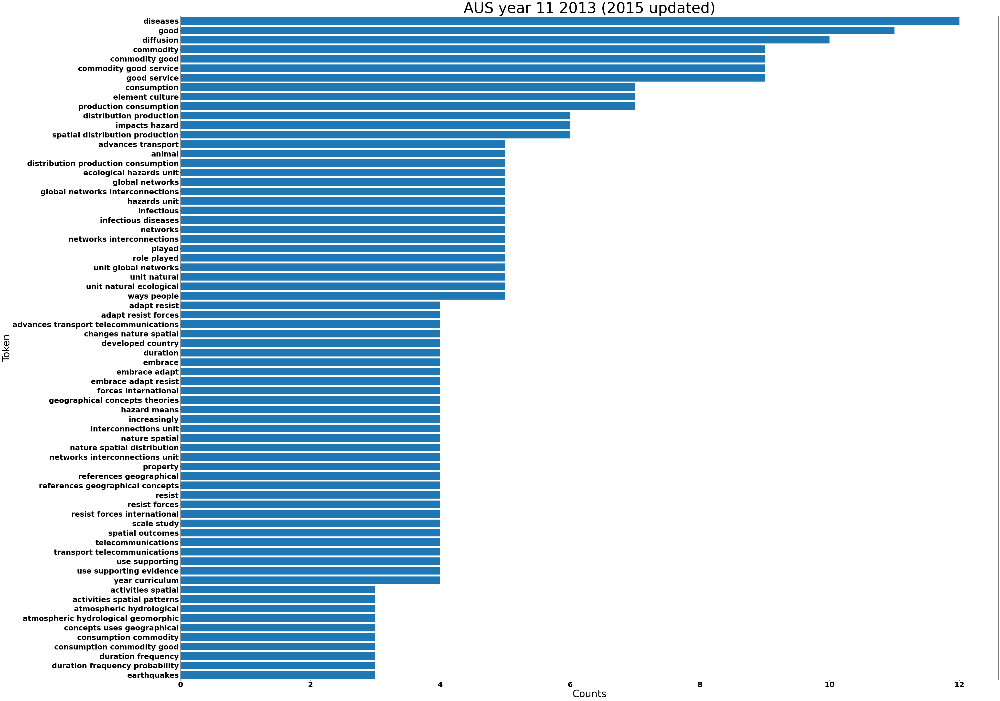

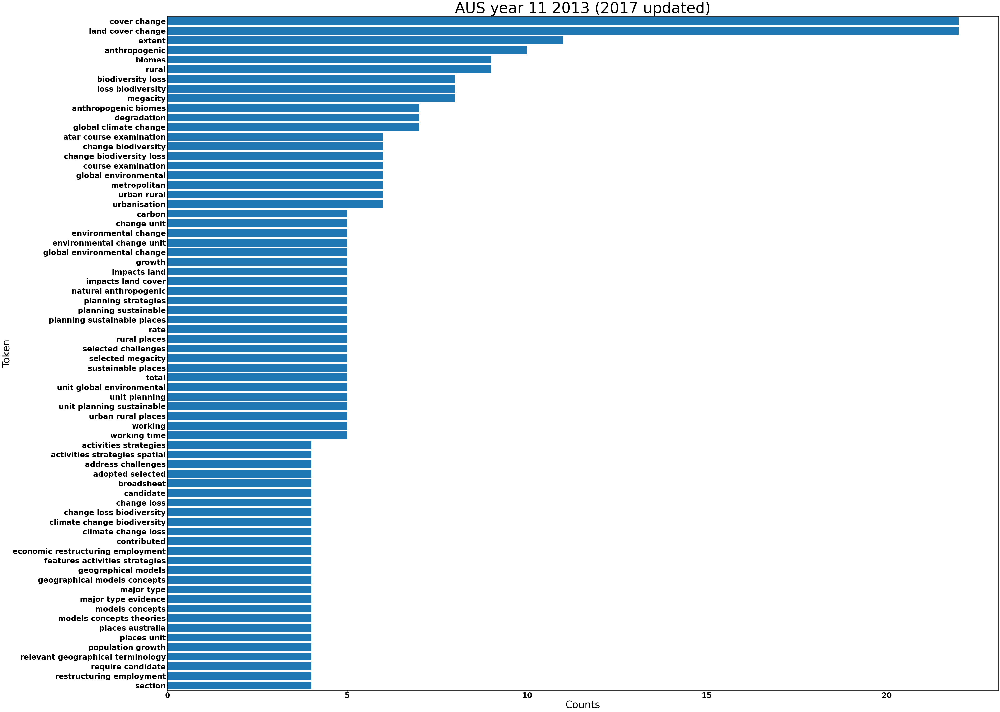

In [159]:
aus_2015 = Document(text_tokens["AUS year 11 2013 (2015 updated)"])
aus_2017 = Document(text_tokens["AUS year 12 2013 (2017 updated)"])

aus_data = {"AUS year 11 2013 (2015 updated)": aus_2015, "AUS year 11 2013 (2017 updated)": aus_2017}

for key, doc in aus_data.items():
    doc.fit_unique_tokens(*list(aus_data.values()))
    plot_bar_horizontal(doc.unique_tokens_frequency, key, x_label="Count", y_label="Token", save_path=os.path.join("output", "unique-terms", "aus"))

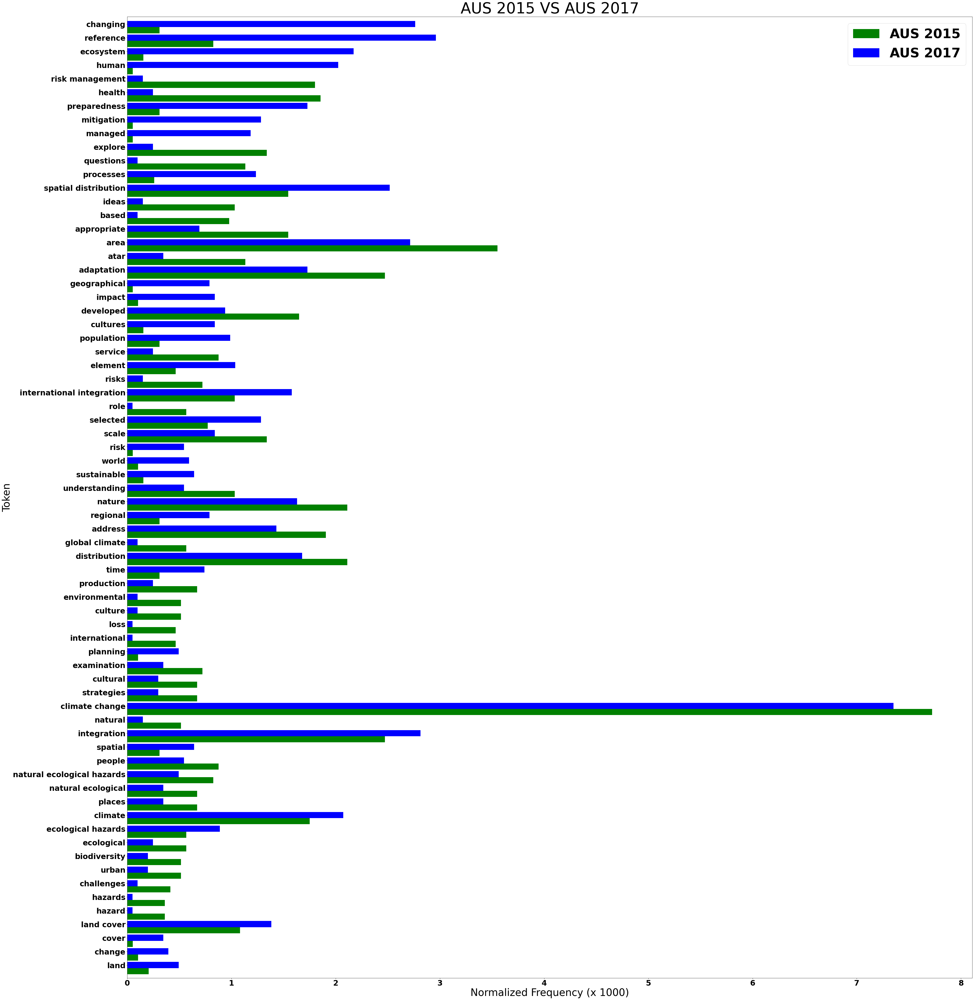

In [160]:
aus_differences = {}

for token, frequecy in aus_2017.common_tokens_frequency.items():
    difference = abs(aus_2017.tokens_proportion[token] - aus_2015.tokens_proportion[token])
    if(difference):
        aus_differences[token] = difference
    
sorted_differences_tuple = sorted(aus_differences.items(), key=lambda item: item[1], reverse=True)
aus_differences = {k: v for k, v in sorted_differences_tuple}

aus_diff_data = { 'tokens': [], 'aus_2015': [], 'aus_2017': [] }
for i, token in enumerate(list(aus_differences.keys())):
    aus_diff_data['tokens'].append(token)
    aus_diff_data['aus_2015'].append(aus_2015.tokens_proportion[token])
    aus_diff_data['aus_2017'].append(aus_2017.tokens_proportion[token])

data_count = 70
X = np.arange(data_count)
height = 0.45

fig = plt.figure(figsize = (60, 70)) 

plt.xlabel("Normalized Frequency (x 1000)", fontsize=40) 
plt.ylabel("Token", fontsize=40) 

plt.title("AUS 2015 VS AUS 2017", fontsize=60)
plt.barh(X, width=aus_diff_data['aus_2015'][:data_count][::-1], height=height, label='AUS 2015', color='g')
plt.barh(X+height, width=aus_diff_data['aus_2017'][:data_count][::-1], height=height, label='AUS 2017', color='b')

plt.yticks(X + height , aus_diff_data['tokens'][:data_count])
plt.ylim(-0.5,data_count)
plt.legend(loc="upper right", fontsize='xx-large')
plt.savefig(os.path.join("output", "common-terms", "aus", "plot.pdf"))
plt.show()

In [161]:
table_data=np.column_stack(
   (
        np.array(aus_diff_data['tokens']),
        np.array(aus_diff_data['aus_2015']),
        np.array(aus_diff_data['aus_2017']),
        np.absolute(np.array(aus_diff_data['aus_2015']) - np.array(aus_diff_data['aus_2017']))
   )
)

df = pd.DataFrame(table_data, columns=['Token', 'AUS 2015', 'AUS_2017', 'Differences'])
df.to_csv(os.path.join("output", "common-terms", "aus", "table.csv"))
df

,Token,AUS 2015,AUS_2017,Differences
0,land,0.3089280197713933,2.7637942947389202,2.454866274967527
1,change,0.8238080527237154,2.9612081729345574,2.137400120210842
2,cover,0.15446400988569664,2.1715526601520088,2.017088650266312
3,land cover,0.05148800329523221,2.0234922515052807,1.9720042482100484
4,hazard,1.8020801153331274,0.14806040864672787,1.6540197066863995
...,...,...,...,...
7991,years copyright school,0.05148800329523221,0.04935346954890929,0.002134533746322921
7992,years geography,0.05148800329523221,0.04935346954890929,0.002134533746322921
7993,years geography atar,0.05148800329523221,0.04935346954890929,0.002134533746322921
7994,years thousands,0.05148800329523221,0.04935346954890929,0.002134533746322921


## IB Data

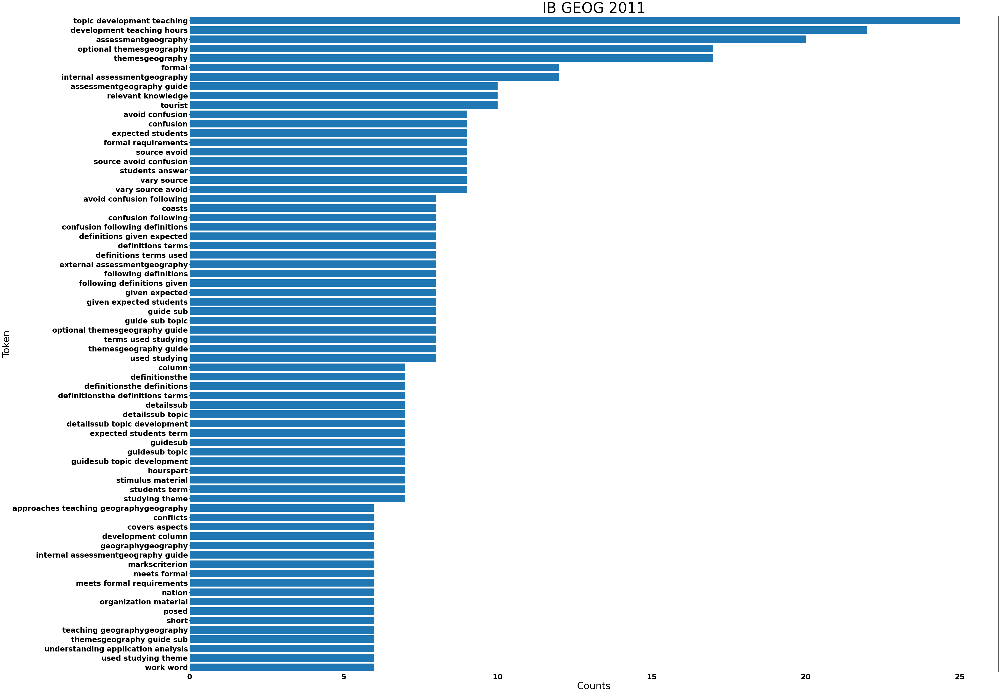

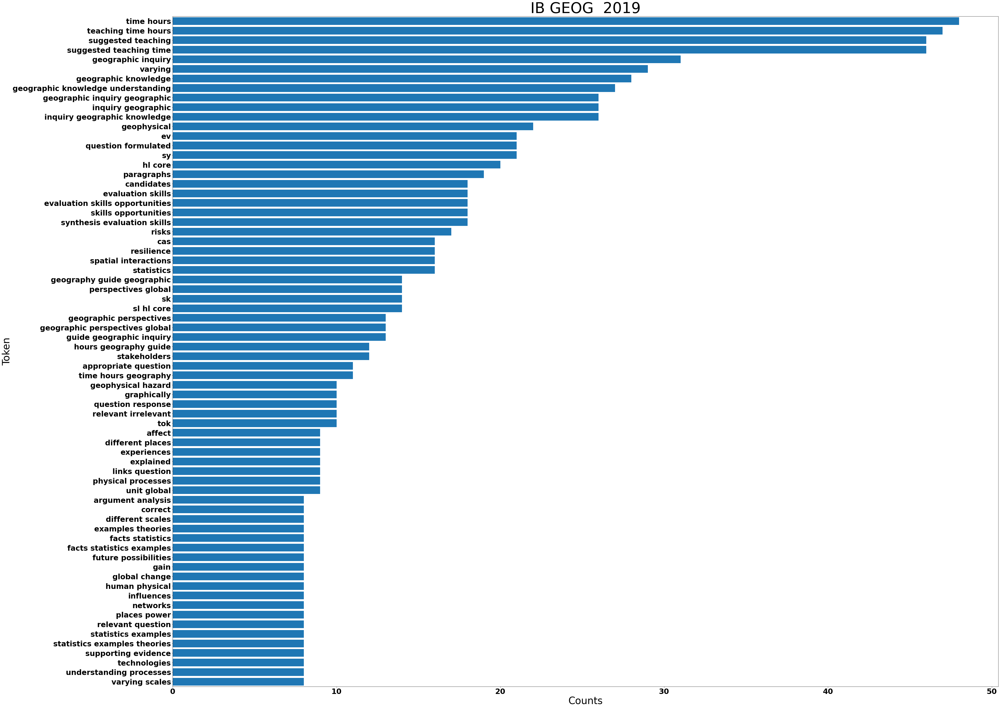

In [162]:
ib_2011 = Document(text_tokens["IB GEOG 2011"])
ib_2019 = Document(text_tokens["IB GEOG  2019"])

ib_data = {"IB GEOG 2011": ib_2011, "IB GEOG  2019": ib_2019}

for key, doc in ib_data.items():
    doc.fit_unique_tokens(*list(ib_data.values()))
    plot_bar_horizontal(doc.unique_tokens_frequency, key, x_label="Count", y_label="Token", save_path=os.path.join("output", "unique-terms", "ib"))

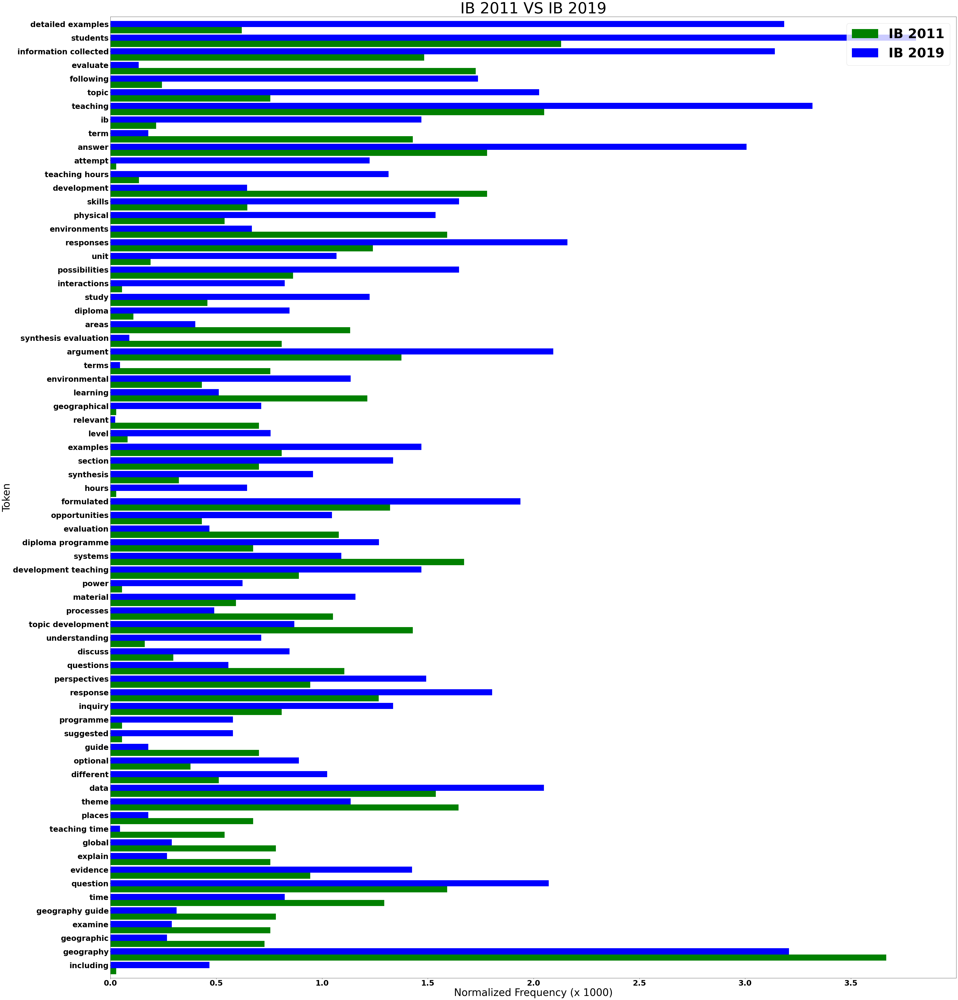

In [163]:
ib_differences = {}
        
for token, frequency in ib_2011.common_tokens_frequency.items():
    difference = abs(ib_2011.tokens_proportion[token] - ib_2019.tokens_proportion[token])
    if(difference):
        ib_differences[token] = difference

sorted_differences_tuple = sorted(ib_differences.items(), key=lambda item: item[1], reverse=True)
ib_differences = {k: v for k, v in sorted_differences_tuple}

ib_diff_data = { 'tokens': [], 'ib_2011': [], 'ib_2019': [] }
for i, token in enumerate(list(ib_differences.keys())):
    ib_diff_data['tokens'].append(token)
    ib_diff_data['ib_2011'].append(ib_2011.tokens_proportion[token])
    ib_diff_data['ib_2019'].append(ib_2019.tokens_proportion[token])

data_count = 70
X = np.arange(data_count)
height = 0.45

fig = plt.figure(figsize = (60, 70)) 

plt.xlabel("Normalized Frequency (x 1000)", fontsize=40) 
plt.ylabel("Token", fontsize=40) 

plt.title("IB 2011 VS IB 2019", fontsize=60)
plt.barh(X, width=ib_diff_data['ib_2011'][:data_count][::-1], height=height, label='IB 2011', color='g')
plt.barh(X+height, width=ib_diff_data['ib_2019'][:data_count][::-1], height=height, label='IB 2019', color='b')

plt.yticks(X + height , ib_diff_data['tokens'][:data_count])
plt.ylim(-0.5,data_count)
plt.legend(loc="upper right", fontsize='xx-large')
plt.savefig(os.path.join("output", "common-terms", "ib", "plot.pdf"))
plt.show()

In [164]:
table_data=np.column_stack(
   (
        np.array(ib_diff_data['tokens']),
        np.array(ib_diff_data['ib_2011']),
        np.array(ib_diff_data['ib_2019']),
        np.absolute(np.array(ib_diff_data['ib_2011']) - np.array(ib_diff_data['ib_2019']))
   )
)

df = pd.DataFrame(table_data, columns=['Token', 'IB 2011', 'IB 2019', 'Differences'])
df.to_csv(os.path.join("output", "common-terms", "ib", "table.csv"))
df

,Token,IB 2011,IB 2019,Differences
0,including,0.6202804746494067,3.184571530375913,2.5642910557265064
1,geography,2.1305285868392665,3.808123997862106,1.6775954110228395
2,geographic,1.483279395900755,3.1400320684126135,1.6567526725118584
3,examine,1.725997842502697,0.13361838588989844,1.5923794566127984
4,geography guide,0.24271844660194175,1.7370390165686798,1.494320569966738
...,...,...,...,...
9081,programme geography course,0.1348435814455232,0.13361838588989844,0.001225195555624753
9082,require students,0.1348435814455232,0.13361838588989844,0.001225195555624753
9083,studied,0.1348435814455232,0.13361838588989844,0.001225195555624753
9084,sub topics,0.1348435814455232,0.13361838588989844,0.001225195555624753


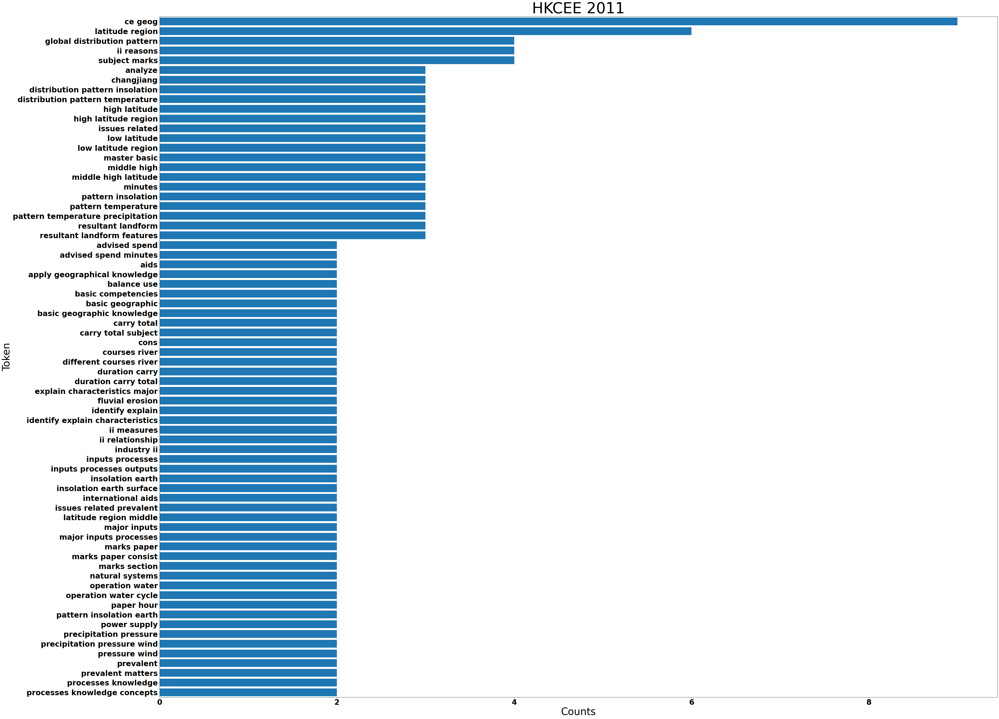

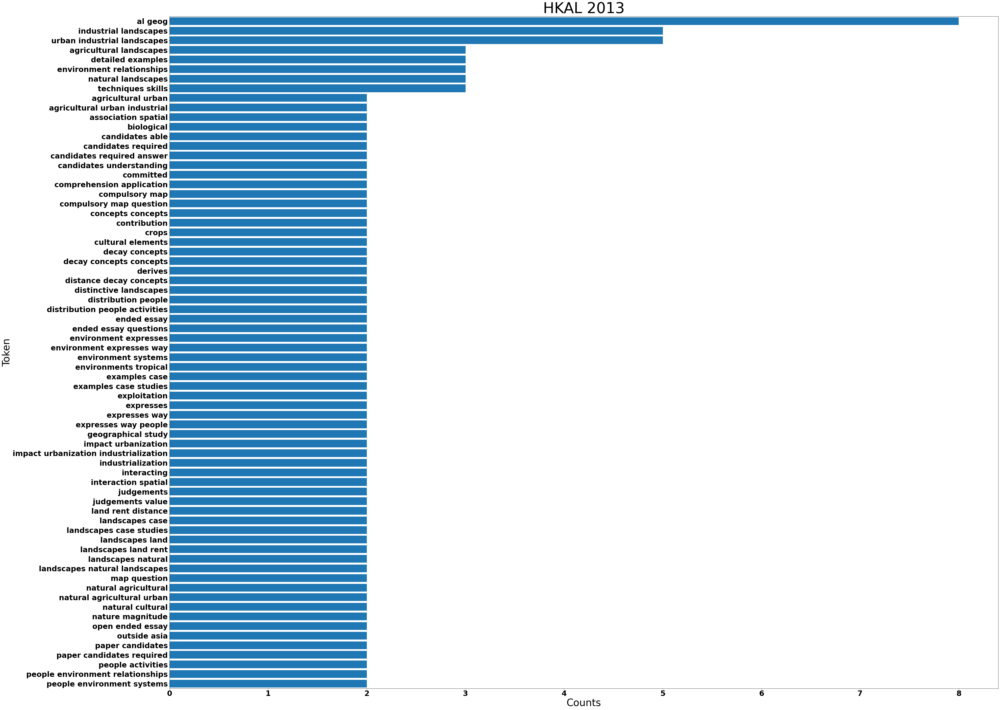

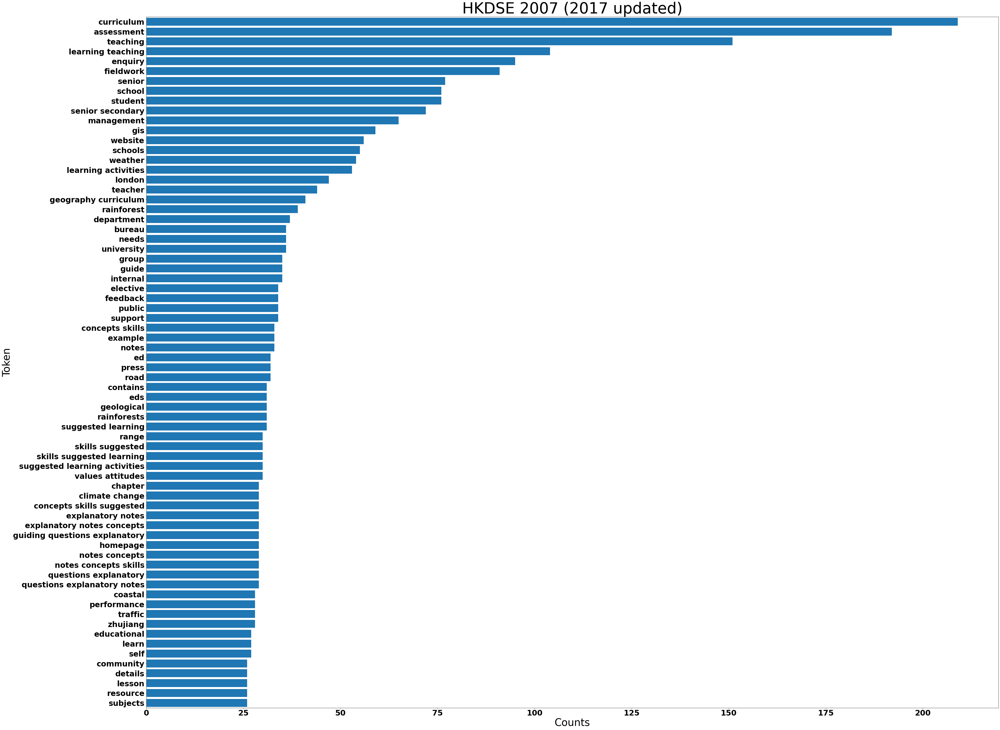

In [165]:
hk_2011 = Document(text_tokens['HKCEE 2011'])
hk_2013 = Document(text_tokens['HKAL 2013'])
hk_2017 = Document(text_tokens['HKDSE 2007 (2017 updated)'])

hk_data = {"HKCEE 2011": hk_2011, "HKAL 2013": hk_2013, "HKDSE 2007 (2017 updated)": hk_2017}

for key, doc in hk_data.items():
    doc.fit_unique_tokens(*list(hk_data.values()))
    plot_bar_horizontal(doc.unique_tokens_frequency, key, x_label="Count", y_label="Token", save_path=os.path.join("output", "unique-terms", "hk"))

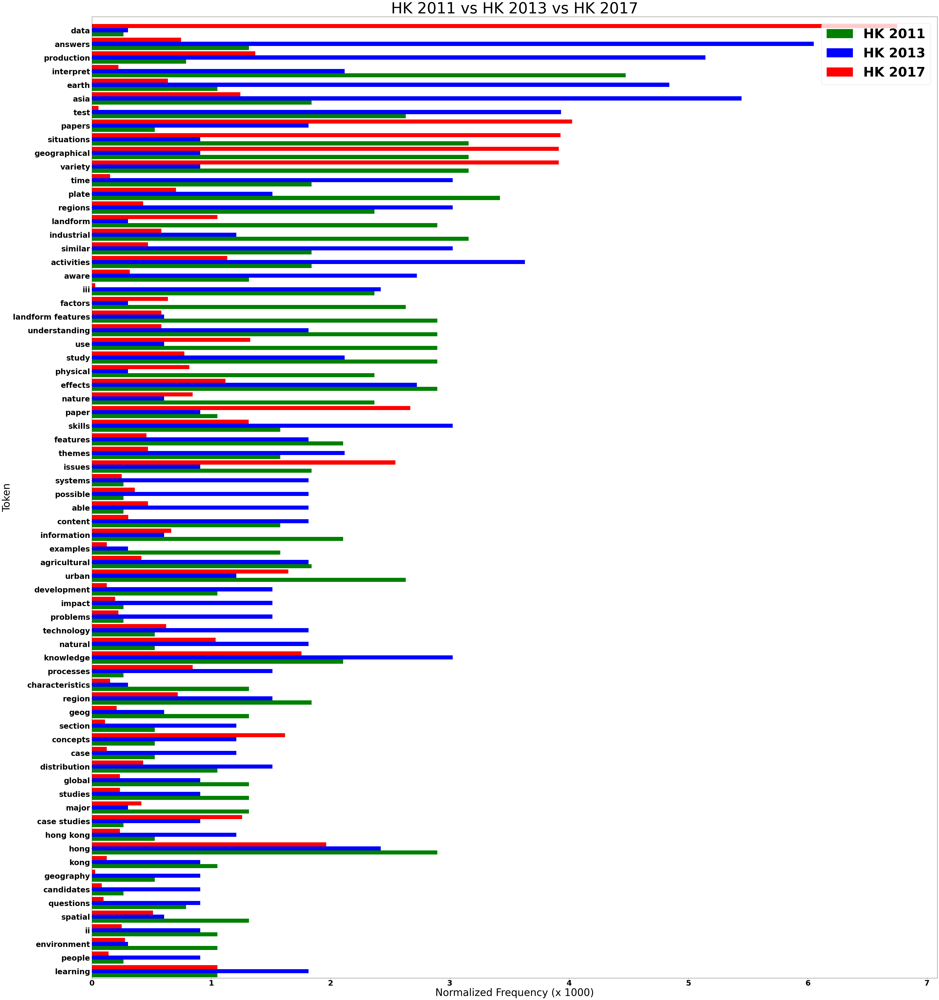

In [166]:
hk_differences = {}
        
for token, frequency in hk_2011.common_tokens_frequency.items():
    difference = (
        abs(hk_2011.tokens_proportion[token] - hk_2013.tokens_proportion[token]) + 
        abs(hk_2013.tokens_proportion[token] - hk_2017.tokens_proportion[token]) +
        abs(hk_2011.tokens_proportion[token] - hk_2017.tokens_proportion[token]) 
    )

    if(difference):
        hk_differences[token] = difference

sorted_differences_tuple = sorted(hk_differences.items(), key=lambda item: item[1], reverse=True)
hk_differences = {k: v for k, v in sorted_differences_tuple}

hk_diff_data = { 'tokens': [], 'hk_2011': [], 'hk_2013': [], 'hk_2017': [] }
for i, token in enumerate(list(hk_differences.keys())):
    hk_diff_data['tokens'].append(token)
    hk_diff_data['hk_2011'].append(hk_2011.tokens_proportion[token])
    hk_diff_data['hk_2013'].append(hk_2013.tokens_proportion[token])
    hk_diff_data['hk_2017'].append(hk_2017.tokens_proportion[token])

data_count = 70
X = np.arange(data_count)
height = 0.30

fig = plt.figure(figsize = (60, 70)) 

plt.xlabel("Normalized Frequency (x 1000)", fontsize=40) 
plt.ylabel("Token", fontsize=40) 

plt.title("HK 2011 vs HK 2013 vs HK 2017", fontsize=60)
plt.barh(X-height, width=hk_diff_data['hk_2011'][:data_count][::-1], height=height, label='HK 2011', color='g')
plt.barh(X, width=hk_diff_data['hk_2013'][:data_count][::-1], height=height, label='HK 2013', color='b')
plt.barh(X+height, width=hk_diff_data['hk_2017'][:data_count][::-1], height=height, label='HK 2017', color='r')

plt.yticks(X , hk_diff_data['tokens'][:data_count])
plt.ylim(-0.5,data_count)
plt.legend(loc="upper right", fontsize='xx-large')
plt.savefig(os.path.join("output", "common-terms", "hk", "plot.pdf"))
plt.show()

In [167]:
table_data=np.column_stack(
   (
        np.array(hk_diff_data['tokens']),
        np.array(hk_diff_data['hk_2011']),
        np.array(hk_diff_data['hk_2013']),
        np.array(hk_diff_data['hk_2017']),
   )
)

df = pd.DataFrame(table_data, columns=['Token', 'HK 2011', 'HK 2013', 'HK 2017'])
df.to_csv(os.path.join("output", "common-terms", "hk", "table.csv"))
df

,Token,HK 2011,HK 2013,HK 2017
0,learning,0.26308866087871613,0.3024803387779794,6.747974224950911
1,people,1.3154433043935807,6.049606775559589,0.7467020658757156
2,environment,0.7892659826361483,5.142165759225651,1.368953787438812
3,ii,4.472507234938174,2.117362371445856,0.2212450565557676
4,spatial,1.0523546435148645,4.839685420447671,0.6360795375978318
...,...,...,...,...
221,tectonics,0.26308866087871613,0.3024803387779794,0.24890068862523854
222,concept,0.26308866087871613,0.3024803387779794,0.30421195276418045
223,essential,0.26308866087871613,0.3024803387779794,0.262728504659974
224,good,0.26308866087871613,0.3024803387779794,0.262728504659974
